# Custom Training with YOLOv5

# Step 1: Install Requirements

In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 15162, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (18/18), done.
remote: Total 15162 (delta 10), reused 14 (delta 6), pack-reused 15138
Receiving objects: 100% (15162/15162), 14.14 MiB | 24.22 MiB/s, done.
Resolving deltas: 100% (10394/10394), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 60.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 81.8 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cvxpy 1.2.3 requires setuptools<=64.0.2, but you have setuptools 67.3.2 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49

# Step 2: Extract the dataset


In [2]:
!unzip "/content/dataset.zip" -d "/content/dataset"

Archive:  /content/dataset.zip
   creating: /content/dataset/test/
   creating: /content/dataset/train/
   creating: /content/dataset/val/
  inflating: /content/dataset/dataset_config.yaml  
   creating: /content/dataset/test/images/
   creating: /content/dataset/test/labels/
  inflating: /content/dataset/test/images/im_118.jpg  
  inflating: /content/dataset/test/images/im_122.jpg  
  inflating: /content/dataset/test/images/im_123.jpg  
  inflating: /content/dataset/test/images/im_147.jpg  
  inflating: /content/dataset/test/images/im_149.jpg  
  inflating: /content/dataset/test/images/im_157.jpg  
  inflating: /content/dataset/test/images/im_167.jpg  
  inflating: /content/dataset/test/images/im_169.jpg  
  inflating: /content/dataset/test/images/im_173.jpg  
  inflating: /content/dataset/test/images/im_203.jpg  
  inflating: /content/dataset/test/images/im_207.jpg  
  inflating: /content/dataset/test/images/im_216.jpg  
  inflating: /content/dataset/test/images/im_26.jpg  
  inflati

# Step 3: Train Our Custom YOLOv5 model

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [7]:
!python train.py --img 640 --batch 32 --epochs 100 --data ../dataset/dataset_config.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=../dataset/dataset_config.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-102-ge4d8360 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv

# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

In [4]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [8]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.1 --source ../dataset/test/images

detect: weights=['runs/train/exp2/weights/best.pt'], source=../dataset/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-102-ge4d8360 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/100 /content/dataset/test/images/im_118.jpg: 480x640 1 {0: 'small_vrac'}, 12.8ms
image 2/100 /content/dataset/test/images/im_122.jpg: 480x640 1 {0: 'small_vrac'}, 11.9ms
image 3/100 /content/dataset/test/images/im_123.jpg: 480x640 1 {0: 'small_vrac'}, 10.1ms
image 4/100 /content/dataset/test/images/im_147.jpg: 480x640 1 {1: 'big_vrac

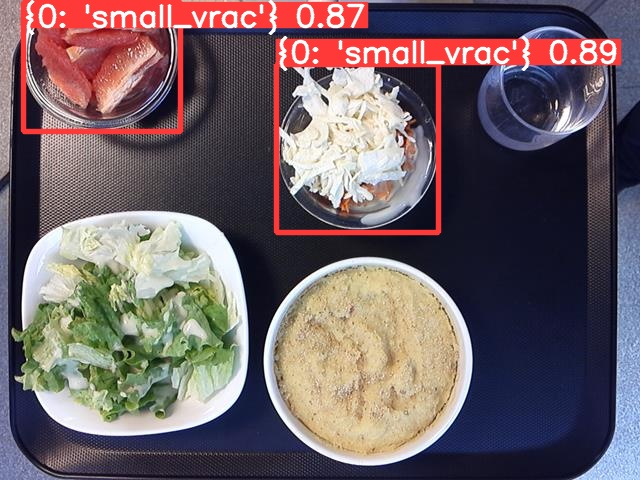

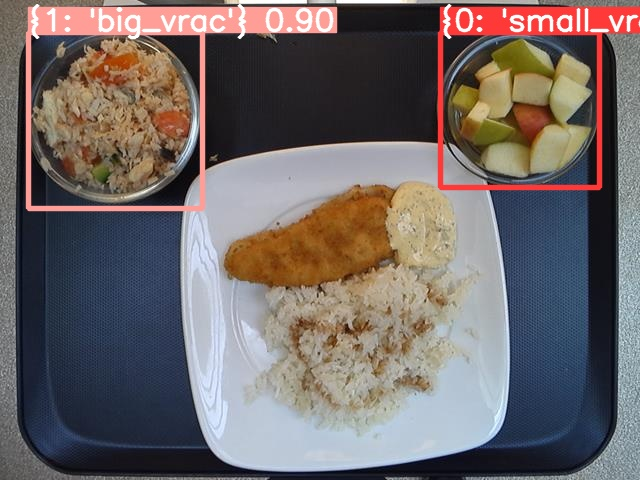

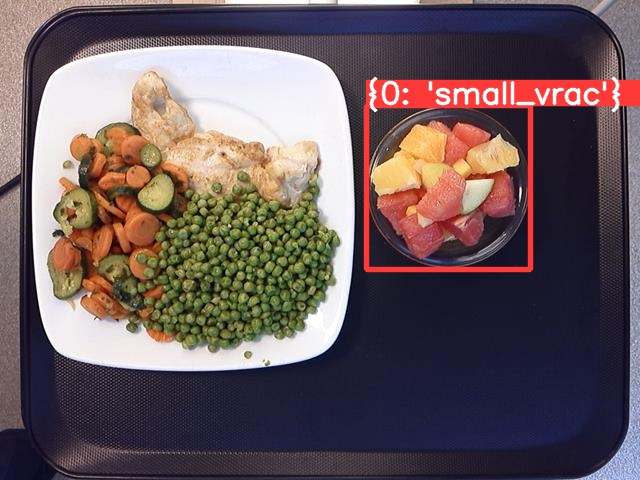

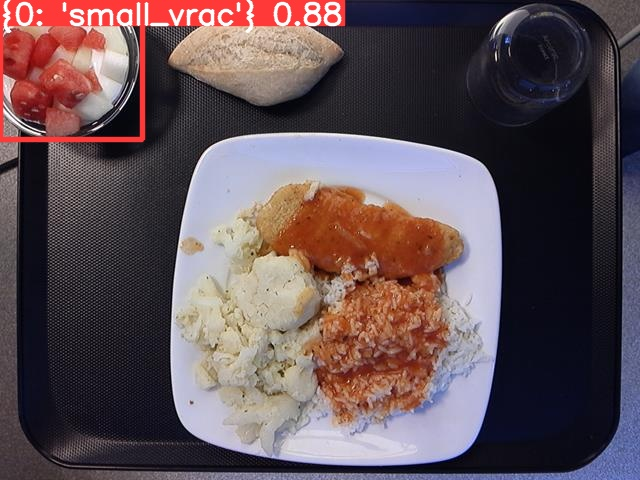

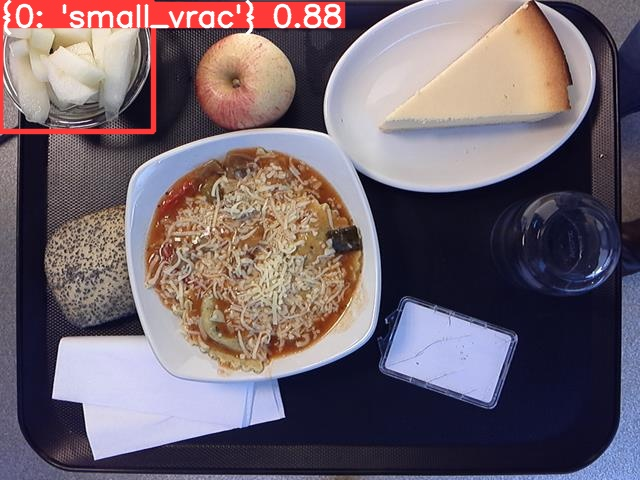

...

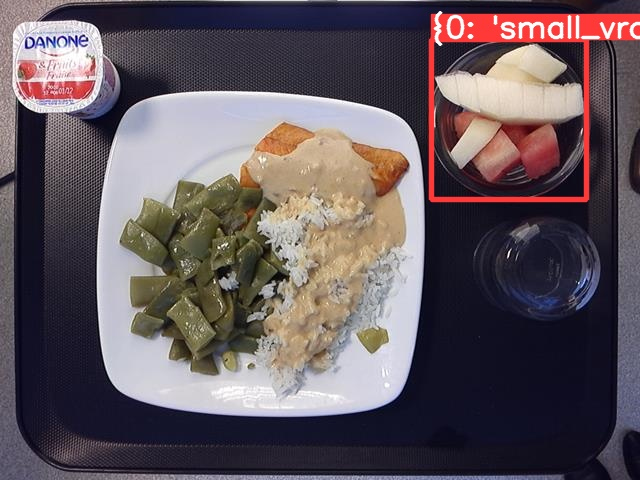

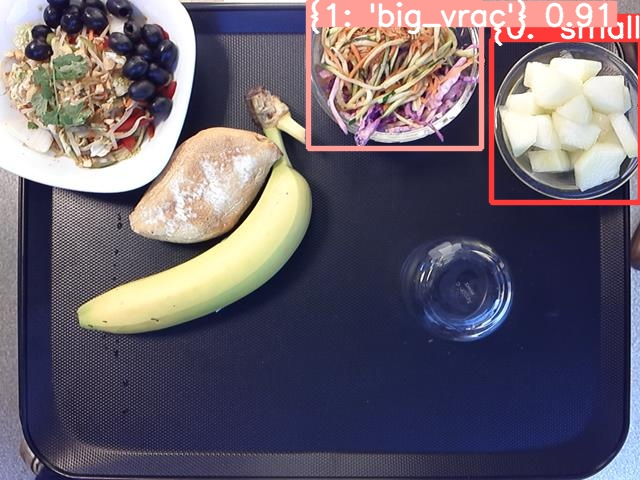

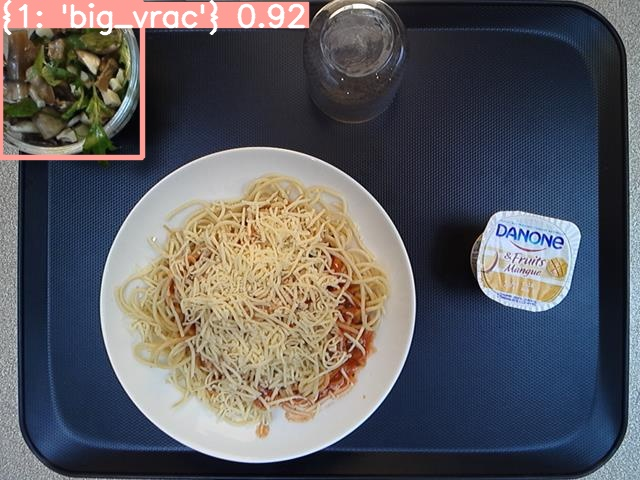

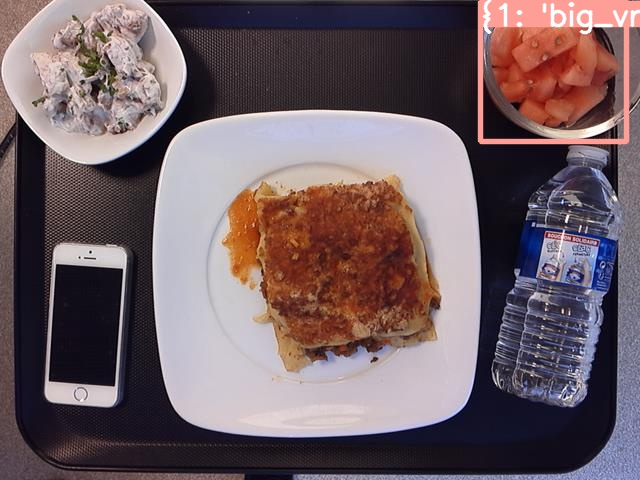

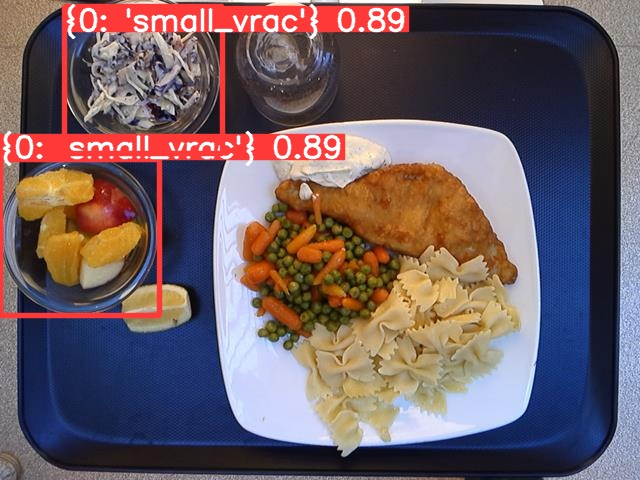

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Conclusion and Next Steps

Congratulations! You've trained a custom YOLOv5 model to recognize your custom objects.

To improve you model's performance, we recommend first interating on your datasets coverage and quality. See this guide for [model performance improvement](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results).

To deploy your model to an application, see this guide on [exporting your model to deployment destinations](https://github.com/ultralytics/yolov5/issues/251).

Once your model is in production, you will want to continually iterate and improve on your dataset and model via [active learning](https://blog.roboflow.com/what-is-active-learning/).

In [9]:
#export your model's weights for future use
from google.colab import files

files.download('./runs/train/exp/weights/best.pt')

updating: content/yolov5/runs/ (stored 0%)
updating: content/yolov5/runs/detect/ (stored 0%)
updating: content/yolov5/runs/detect/exp/ (stored 0%)
updating: content/yolov5/runs/detect/exp/im_475.jpg (deflated 6%)
updating: content/yolov5/runs/detect/exp/im_821.jpg (deflated 4%)
updating: content/yolov5/runs/detect/exp/im_677.jpg (deflated 6%)
updating: content/yolov5/runs/detect/exp/im_964.jpg (deflated 4%)
updating: content/yolov5/runs/detect/exp/im_733.jpg (deflated 7%)
updating: content/yolov5/runs/detect/exp/im_37.jpg (deflated 6%)
updating: content/yolov5/runs/detect/exp/im_26.jpg (deflated 5%)
updating: content/yolov5/runs/detect/exp/im_147.jpg (deflated 9%)
updating: content/yolov5/runs/detect/exp/im_432.jpg (deflated 8%)
updating: content/yolov5/runs/detect/exp/im_265.jpg (deflated 7%)
updating: content/yolov5/runs/detect/exp/im_318.jpg (deflated 6%)
updating: content/yolov5/runs/detect/exp/im_216.jpg (deflated 5%)
updating: content/yolov5/runs/detect/exp/im_875.jpg (deflated 6

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>